##REAL OR FAKE JOB POSTING PREDICTION
This dataset contains 18K job descriptions out of which about 800 are fake.
The data consists of both textual information and meta-information about the jobs.

The objective is to create a classification model that uses text data features and meta-features and predict which job description are fraudulent or real.

Link for the dataset:
https://www.kaggle.com/shivamb/real-or-fake-fake-jobposting-prediction

In [ ]:
#importing necessary libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Embedding
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.text import one_hot
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Bidirectional
from tensorflow.keras.layers import Dropout
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, f1_score, recall_score, precision_score, classification_report, accuracy_score
import nltk
import re
from nltk.corpus import stopwords

In [ ]:
#load the dataset
df1=pd.read_csv("/content/drive/MyDrive/fakejob.csv")

In [ ]:
df1.head()

,job_id,title,location,department,salary_range,company_profile,description,requirements,benefits,telecommuting,has_company_logo,has_questions,employment_type,required_experience,required_education,industry,function,fraudulent
0,1,Marketing Intern,"US, NY, New York",Marketing,NaN,"We're Food52, and we've created a groundbreaki...","Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,NaN,0,1,0,Other,Internship,NaN,NaN,Marketing,0
1,2,Customer Service - Cloud Video Production,"NZ, , Auckland",Success,NaN,"90 Seconds, the worlds Cloud Video Production ...",Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,What you will get from usThrough being part of...,0,1,0,Full-time,Not Applicable,NaN,Marketing and Advertising,Customer Service,0
2,3,Commissioning Machinery Assistant (CMA),"US, IA, Wever",NaN,NaN,Valor Services provides Workforce Solutions th...,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,NaN,0,1,0,NaN,NaN,NaN,NaN,NaN,0
3,4,Account Executive - Washington DC,"US, DC, Washington",Sales,NaN,Our passion for improving quality of life thro...,THE COMPANY: ESRI – Environmental Systems Rese...,"EDUCATION: Bachelor’s or Master’s in GIS, busi...",Our culture is anything but corporate—we have ...,0,1,0,Full-time,Mid-Senior level,Bachelor's Degree,Computer Software,Sales,0
4,5,Bill Review Manager,"US, FL, Fort Worth",NaN,NaN,SpotSource Solutions LLC is a Global Human Cap...,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,Full Benefits Offered,0,1,1,Full-time,Mid-Senior level,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0


In [ ]:
df1.shape

(17880, 18)

In [ ]:
df1.columns

Index(['job_id', 'title', 'location', 'department', 'salary_range',
       'company_profile', 'description', 'requirements', 'benefits',
       'telecommuting', 'has_company_logo', 'has_questions', 'employment_type',
       'required_experience', 'required_education', 'industry', 'function',
       'fraudulent'],
      dtype='object')

In [ ]:
# Removing NAN values and useless columns
columns=['job_id', 'telecommuting', 'has_company_logo', 'has_questions', 'salary_range', 'employment_type']
for col in columns:
    del df1[col]

df1.fillna(' ', inplace=True)

In [ ]:
#checking which country posts most number of jobs
def split(location):
    l = location.split(',')
    return l[0]

df1['country'] = df1.location.apply(split)

Text(0.5, 0, 'Countries')

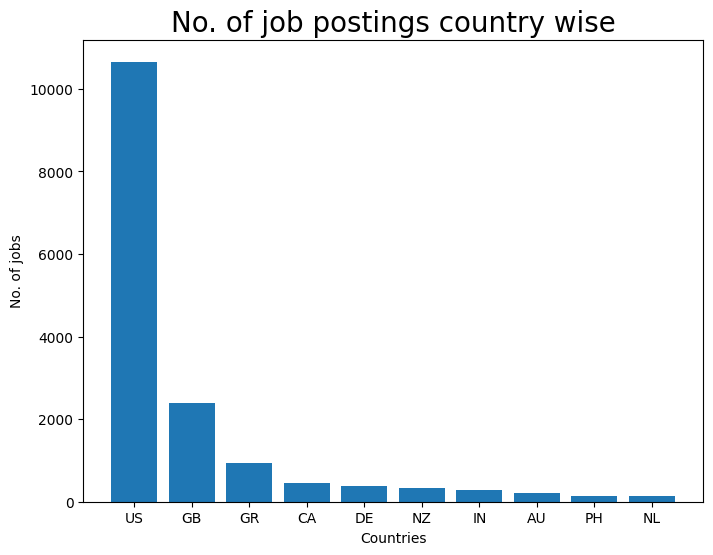

In [ ]:
country = dict(df1.country.value_counts()[:11])
del country[' ']
plt.figure(figsize=(8,6))
plt.title('No. of job postings country wise', size=20)
plt.bar(country.keys(), country.values())
plt.ylabel('No. of jobs', size=10)
plt.xlabel('Countries', size=10)

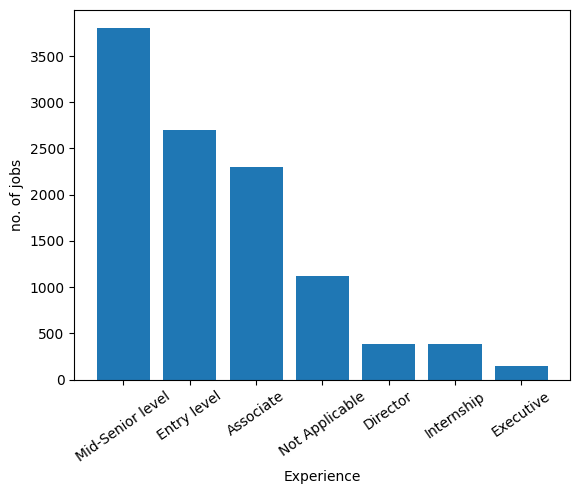

In [ ]:
# checking about which type of experience is required in most number of jobs
experience = dict(df1.required_experience.value_counts())
del experience[' ']
plt.bar(experience.keys(), experience.values())
plt.xlabel('Experience', size=10)
plt.ylabel('no. of jobs', size=10)
plt.xticks(rotation=35)
plt.show()

In [ ]:
# Which industry have the maximum number of fake job postings?
# Group the data by the 'industry' column and count the occurrences of 'fake' values
df_vc = df1[df1['fraudulent'] == 1].groupby('industry')['industry'].count()
# Sort the industry counts in descending order
sorted_industry_counts = df_vc.sort_values(ascending=False)
# Print the industries and their fake job posting counts in descending order
for industry, count in sorted_industry_counts.items():
    print(f"Industry: {industry}, Fake Job Postings Count: {count}")

Industry:  , Fake Job Postings Count: 275
Industry: Oil & Energy, Fake Job Postings Count: 109
Industry: Accounting, Fake Job Postings Count: 57
Industry: Hospital & Health Care, Fake Job Postings Count: 51
Industry: Marketing and Advertising, Fake Job Postings Count: 45
Industry: Financial Services, Fake Job Postings Count: 35
Industry: Information Technology and Services, Fake Job Postings Count: 32
Industry: Telecommunications, Fake Job Postings Count: 26
Industry: Consumer Services, Fake Job Postings Count: 24
Industry: Real Estate, Fake Job Postings Count: 24
Industry: Leisure, Travel & Tourism, Fake Job Postings Count: 21
Industry: Health, Wellness and Fitness, Fake Job Postings Count: 15
Industry: Hospitality, Fake Job Postings Count: 14
Industry: Computer Networking, Fake Job Postings Count: 12
Industry: Staffing and Recruiting, Fake Job Postings Count: 8
Industry: Management Consulting, Fake Job Postings Count: 6
Industry: Human Resources, Fake Job Postings Count: 6
Industry: 

In [ ]:
#selecting only important columns as there are many columns in the dataset
df=df1[['description','requirements','fraudulent']]
df.head()

,description,requirements,fraudulent
0,"Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,0
1,Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,0
2,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,0
3,THE COMPANY: ESRI – Environmental Systems Rese...,"EDUCATION: Bachelor’s or Master’s in GIS, busi...",0
4,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,0


In [ ]:
#checking for the total number of null values in the dataset
df.isna().sum()

description     0
requirements    0
fraudulent      0
dtype: int64

In [ ]:
#dropping null values from the dataset
df=df.dropna()

In [ ]:
df.shape

(17880, 3)

In [ ]:
from wordcloud import WordCloud

In [ ]:
fraud=" ".join(df[df["fraudulent"]==1]["description"])
fraud

'IC&amp;E Technician | Bakersfield, CA Mt. PosoPrincipal Duties and Responsibilities:\xa0Calibrates, tests, maintains, troubleshoots, and installs all power plant instrumentation, control systems and electrical equipment.Performs maintenance on motor control centers, motor operated valves, generators, excitation equipment and motors.Performs preventive, predictive and corrective maintenance on equipment, coordinating work with various team members.Designs and installs new equipment and/or system modifications.Troubleshoots and performs maintenance on DC backup power equipment, process controls, programmable logic controls (PLC), and emission monitoring equipment.Uses maintenance reporting system to record time and material use, problem identified and corrected, and further action required; provides complete history of maintenance on equipment.Schedule, coordinate, work with and monitor contractors on specific tasks, as required.Follows safe working practices at all times.Identifies saf

In [ ]:
real=" ".join(df[df["fraudulent"]==0]["description"])
real

'Food52, a fast-growing, James Beard Award-winning online food community and crowd-sourced and curated recipe hub, is currently interviewing full- and part-time unpaid interns to work in a small team of editors, executives, and developers in its New York City headquarters.Reproducing and/or repackaging existing Food52 content for a number of partner sites, such as Huffington Post, Yahoo, Buzzfeed, and more in their various content management systemsResearching blogs and websites for the Provisions by Food52 Affiliate ProgramAssisting in day-to-day affiliate program support, such as screening affiliates and assisting in any affiliate inquiriesSupporting with PR &amp; Events when neededHelping with office administrative work, such as filing, mailing, and preparing for meetingsWorking with developers to document bugs and suggest improvements to the siteSupporting the marketing and executive staff Organised - Focused - Vibrant - Awesome!Do you have a passion for customer service? Slick typ

(-0.5, 799.5, 899.5, -0.5)

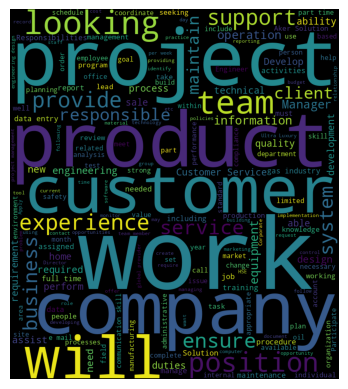

In [ ]:
wc=WordCloud(width=800,height=900,background_color="black",min_font_size=12)
wc.generate(fraud)
plt.imshow(wc)
plt.axis("off")

(-0.5, 799.5, 899.5, -0.5)

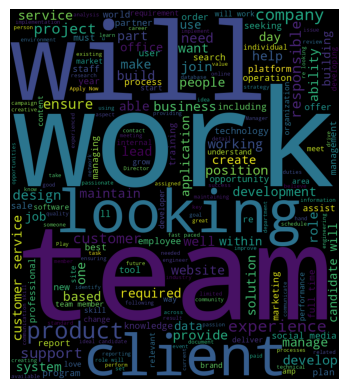

In [ ]:
wc=WordCloud(width=800,height=900,background_color="black",min_font_size=12)
wc.generate(real)
plt.imshow(wc)
plt.axis("off")

In [ ]:
#splitting dataset into x (independent variables) and y (dependent variable)
x=df.iloc[:,:-1]    #to select all rows and all columns except the last one
y=df.iloc[:,-1]     #to select last column which is target column

In [ ]:
voc_size=5000
#limiting vocabulary size to the top 5000 most frequently occurring words in your text corpus.
#Words outside this vocabulary would either be ignored or replaced with a special token.

In [ ]:
#copying content of x to new variable 'message' to ensure that changes made to 'message' do not affect the original DataFrame x.
message = x.copy()
message.head()

,description,requirements
0,"Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...
1,Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...
2,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...
3,THE COMPANY: ESRI – Environmental Systems Rese...,"EDUCATION: Bachelor’s or Master’s in GIS, busi..."
4,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...


In [ ]:
message['description'][1]

"Organised - Focused - Vibrant - Awesome!Do you have a passion for customer service? Slick typing skills? Maybe Account Management? ...And think administration is cooler than a polar bear on a jetski? Then we need to hear you!\xa0We are the Cloud Video Production Service and opperating on a glodal level. Yeah, it's pretty cool. Serious about\xa0delivering a world class product and excellent customer service.Our rapidly expanding business is looking for a talented Project Manager to manage the successful delivery of video projects, manage client communications and drive the production process. Work with some of the coolest brands on the planet and learn from a global team that are representing NZ is a huge way!We are entering the next growth stage of our business and growing quickly internationally. \xa0Therefore, the position is bursting with opportunity for the right person entering the business at the right time.\xa090 Seconds, the worlds Cloud Video Production Service -\xa0http://90

In [ ]:
message.reset_index(inplace=True)
#The reset_index() method helps to reset the index back to the default integer index,
#and the inplace=True argument ensures that the modification is done on the DataFrame itself, without creating a new DataFrame.

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
#Stemming is a process of reducing words to their root form, which can help to normalize the text and reduce word variations
from nltk.stem.porter import PorterStemmer
ps = PorterStemmer()  #Creating an instance of the PorterStemmer class, which will be used for stemming words.
corpus = [] # Creating an empty list named corpus where preprocessed text will be stored.
for i in range(0, len(message)):
#Removing all characters that are not letters (using a regular expression) and replacing them with spaces.
#This step effectively removes any special characters, digits, or punctuation from the text.
    review = re.sub('[^a-zA-Z]', ' ', message['description'][i])
    review = review.lower()   # Converting the entire text to lowercase. This step helps in standardizing the text and avoiding case sensitivity
    review = review.split()   #Splitting the text into a list of words
#Applying stemming using the PorterStemmer on each word in the list while also removing any words that are in the NLTK English stopwords list
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)   #Joining the stemmed words back together into a single string.
    corpus.append(review)     #Adding the preprocessed and stemmed text to the corpus list.

In [ ]:
corpus[1] #content of the corpus list after the preprocessing steps #processed text of the second entry in the corpus list

'organis focus vibrant awesom passion custom servic slick type skill mayb account manag think administr cooler polar bear jetski need hear cloud video product servic opper glodal level yeah pretti cool seriou deliv world class product excel custom servic rapidli expand busi look talent project manag manag success deliveri video project manag client commun drive product process work coolest brand planet learn global team repres nz huge way enter next growth stage busi grow quickli intern therefor posit burst opportun right person enter busi right time second world cloud video product servic http url fbe afac cd c f b eef e e f ca dd second world cloud video product servic enabl brand agenc get high qualiti onlin video content shot produc anywher world fast afford manag seamlessli cloud purchas publish second remov hassl cost risk speed issu work regular video product compani manag everi aspect video project beauti onlin experi grow network rate video profession countri dedic product suc

In [ ]:
onehot_repr=[one_hot(words,voc_size)for words in corpus]
#A one-hot representation is a binary vector where each word in the vocabulary is represented by a unique index position,
# and only the index corresponding to the current word is set to 1, while all others are set to 0
onehot_repr[1]
#output appears to be a list of integers, where each integer represents the index of a word in the vocabulary so it won't be in binary

[2955,
 3313,
 2137,
 1375,
 2521,
 4738,
 981,
 3636,
 4261,
 3057,
 2069,
 96,
 3456,
 4982,
 1237,
 2354,
 113,
 1263,
 4109,
 3715,
 2559,
 276,
 871,
 823,
 981,
 854,
 1598,
 551,
 968,
 4176,
 4063,
 959,
 2681,
 169,
 3970,
 823,
 2340,
 4738,
 981,
 665,
 4677,
 3865,
 1026,
 1231,
 2438,
 3456,
 3456,
 1668,
 3783,
 871,
 2438,
 3456,
 1420,
 2479,
 1460,
 823,
 272,
 1575,
 3104,
 4461,
 3341,
 3763,
 3833,
 4728,
 2990,
 472,
 4112,
 3708,
 1923,
 1401,
 851,
 4105,
 3865,
 292,
 3873,
 891,
 4838,
 4001,
 2209,
 2848,
 2509,
 4918,
 1923,
 3865,
 2509,
 1595,
 2287,
 169,
 276,
 871,
 823,
 981,
 3783,
 1514,
 4975,
 2433,
 1274,
 4272,
 1794,
 147,
 1416,
 2204,
 2204,
 1794,
 2888,
 4983,
 2287,
 169,
 276,
 871,
 823,
 981,
 4572,
 4461,
 1771,
 1301,
 2335,
 3908,
 3757,
 871,
 3028,
 2398,
 2718,
 2038,
 169,
 3448,
 2849,
 3456,
 1263,
 276,
 3203,
 2398,
 2287,
 3489,
 3866,
 4513,
 4989,
 4760,
 299,
 1575,
 1963,
 871,
 823,
 130,
 3456,
 39,
 1580,
 871,
 2438,
 

In [ ]:
#Embedding Representation ((onehot_repr) into padded sequences of fixed length (sent_length))
sent_length=40
embedded_docs=pad_sequences(onehot_repr,padding='pre',maxlen=sent_length)
#padding='pre' specifies that the padding should be added at the beginning of each sequence (so the zeros are added to the left).
print(embedded_docs)

[[4391 3028 3456 ...  619 3501 3398]
 [1668 2844 4050 ...  640 4790  981]
 [   0    0    0 ... 1032 4020 1112]
 ...
 [2184 3340 3068 ... 2161  756 4331]
 [1654 3783 1353 ... 4577  891 2438]
 [  37 3193 3637 ... 1344 2902 4756]]


In [ ]:
embedded_docs[1]

array([1668, 2844, 4050, 1119, 1471,  230, 1794, 2287, 2718, 2056,  871,
       2030, 3833, 4461, 4139,  169, 4795, 4139, 3437, 1633, 4761, 4667,
       2241, 1940, 2985, 4335, 4002, 1863, 2318, 4566, 2985, 1940, 1974,
       2509,  180, 3320, 3124,  640, 4790,  981], dtype=int32)

In [ ]:
## Creating model
embedding_vector_features=50
model1=Sequential()
model1.add(Embedding(voc_size,embedding_vector_features,input_length=sent_length))
model1.add(Bidirectional(LSTM(100))) ##Just add bidirectional, except it would just behave as normal LSTM Model
model1.add(Dropout(0.3))
model1.add(Dense(1,activation='sigmoid'))
model1.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])
#print(model1.summary())

In [ ]:
len(embedded_docs),y.shape

(17880, (17880,))

In [ ]:
#converting data into NumPy arrays
xfinal=np.array(embedded_docs)
yfinal=np.array(y)

In [ ]:
xfinal[1]

array([1668, 2844, 4050, 1119, 1471,  230, 1794, 2287, 2718, 2056,  871,
       2030, 3833, 4461, 4139,  169, 4795, 4139, 3437, 1633, 4761, 4667,
       2241, 1940, 2985, 4335, 4002, 1863, 2318, 4566, 2985, 1940, 1974,
       2509,  180, 3320, 3124,  640, 4790,  981], dtype=int32)

In [ ]:
#spliting data into training and testing sets
xtrain, xtest, ytrain, ytest = train_test_split(xfinal, yfinal, test_size=0.25, random_state=32)

In [ ]:
#training data
model1.fit(xtrain,ytrain,validation_data=(xtest,ytest),epochs=12,batch_size=64)

Epoch 1/12
210/210 [==============================] - 35s 144ms/step - loss: 0.1888 - accuracy: 0.9551 - val_loss: 0.1334 - val_accuracy: 0.9644
Epoch 2/12
210/210 [==============================] - 29s 139ms/step - loss: 0.0934 - accuracy: 0.9725 - val_loss: 0.1225 - val_accuracy: 0.9705
Epoch 3/12
210/210 [==============================] - 29s 136ms/step - loss: 0.0591 - accuracy: 0.9823 - val_loss: 0.1034 - val_accuracy: 0.9734
Epoch 4/12
210/210 [==============================] - 29s 138ms/step - loss: 0.0383 - accuracy: 0.9878 - val_loss: 0.1222 - val_accuracy: 0.9747
Epoch 5/12
210/210 [==============================] - 29s 138ms/step - loss: 0.0213 - accuracy: 0.9931 - val_loss: 0.1333 - val_accuracy: 0.9767
Epoch 6/12
210/210 [==============================] - 29s 139ms/step - loss: 0.0115 - accuracy: 0.9966 - val_loss: 0.1460 - val_accuracy: 0.9736
Epoch 7/12
210/210 [==============================] - 29s 139ms/step - loss: 0.0087 - accuracy: 0.9977 - val_loss: 0.2058 - val_ac

In [ ]:
#evaluate the model
model1.evaluate(xtest, ytest)

140/140 [==============================] - 2s 17ms/step - loss: 0.2418 - accuracy: 0.9727


[0.24182961881160736, 0.9727069139480591]

In [ ]:
#make prediction on testing data using trained model
y_pred=model1.predict(xtest)

140/140 [==============================] - 3s 16ms/step


In [ ]:
#the threshold of 0.5 is commonly used to decide between the two classes.
#For each value, if threshold is greater than or equal to 0.5, it assigns 1; otherwise, it assigns 0. This creates a list of binary predictions.
preds_y = [1 if x >=0.5 else 0 for x in y_pred] #providing threshold value
print("Accuracy  {:.3} %".format(accuracy_score(ytest, preds_y)*100))
print("Recall Score  {:.3} %".format(recall_score(ytest, preds_y)*100))
print("Precision Score  {:.3} %".format(precision_score(ytest, preds_y)*100))
print("F1 Score  {:.3} %".format(f1_score(ytest, preds_y)*100))

Accuracy  97.3 %
Recall Score  61.9 %
Precision Score  78.9 %
F1 Score  69.3 %


In [ ]:
print(classification_report(ytest, preds_y))

              precision    recall  f1-score   support

           0       0.98      0.99      0.99      4247
           1       0.79      0.62      0.69       223

    accuracy                           0.97      4470
   macro avg       0.88      0.81      0.84      4470
weighted avg       0.97      0.97      0.97      4470



Prediction on Unknown job descrition

In [ ]:
unknown_text = "About the CompanyThis is anÂ amazing job opportunity with one of the most robust companies in the EnergyÂ Industry! Opportunities for advancement are extensive as theÂ company is currently growing and looking for outstanding employees to grow with it. Strong compensation and benefits packages areÂ available for qualified candidates who want to join the largest player in the BakkenÂ Shale and leader in the Oklahoma Shale plays. Contact us today for an opportunity to join one of the Industryâ€™s leaders in the mission to achieve American energyÂ independence!Please note: This job will require relocation to Oklahoma City, OK.SummaryAssist in preparing completions, testing, and workover procedures. Maintain project management control over equipment installation, well completion, and workovers.Essential Job FunctionsMonitor completion operations, costs, and profitability.Design and implementÂ completion and well workover plans and procedures.Generate and review AFEs for capital expenditures.Review expenditures for properties within a specified area.AnalyzeÂ well problems and direct actions to be taken.Work well in a fast paced environment.Solve minor problems with little supervision.Consult with Completion Manager on higher risk and more complex problems and projects.Track costs and operational efficiency on a daily basis and report trends.Perform post completion appraisal and provide recommendations for performance improvement.Work with Completion Foremen to ensure safe and efficient operations.Support asset teams as requested.Assure compliance with governmental requirements and company policies.Provide training and resources to accomplish production goals."

In [ ]:
unknown_text2="collecting and entering data in databases and maintaining accurate records of valuable company information"

In [ ]:
unknown_text3="Collaborating with finance and sales professionals to maintain accounts receivable. Compiling and process information such as prices, discounts, shipping rates etc. Ensuring customers are billed correctly for services offered."

In [ ]:
unknown_text4="Jaco Oil and Refined Resources have partnered up in an effort to streamline the hiring process and provide a more efficient and effective recruitng model.Â  Our focus is to help develop and achieve your career goals while makeing a solid geographical, cultural and professional fiit when leveraging your career into your new and exciting professional venture!Please direct all communications to the HR Department within Refined Resources (#URL_80d75e0d07ca8b108539318a0443bfe5d1ff472afa0c4540b77079c5d5f31eee#)Â #EMAIL_0b13a2cfd4718ce252c09b2353d692a73bd32552e922c5db6cad5fb7e9a2c6c3#Darren Lawson | VP of Recruiting |Â #EMAIL_395225df8eed70288fc67310349d63d49d5f2ca6bc14dbb5dcbf9296069ad88c#Â | #PHONE_70128aad0c118273b0c2198a08d528591b932924e165b6a8d1272a6f9e2763d1#"

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
tokenizer = Tokenizer(num_words=10000, oov_token='<OOV>')
tokenizer.fit_on_texts(unknown_text)
max_sequence_length = 100

In [ ]:
# Preprocess the unknown text
unknown_sequence = tokenizer.texts_to_sequences([unknown_text])
unknown_padded = pad_sequences(unknown_sequence, maxlen=max_sequence_length, padding='post')

In [ ]:
# Make prediction
prediction = model1.predict(unknown_padded)

1/1 [==============================] - 0s 33ms/step


In [ ]:
# Interpret the prediction
if prediction >= 0.5:
    prediction_label = "Fake"
else:
    prediction_label = "Real"

In [ ]:
print(f"The job description is predicted as: {prediction_label} (Score: {prediction[0][0]:.4f})")

The job description is predicted as: Fake (Score: 0.9998)
